In [1]:
%load_ext autoreload
%autoreload 2

%matplotlib inline

In [2]:
from typing import Union

In [3]:
from PIL import Image as PImage
from PIL.Image import Image

In [4]:
from pathlib import Path

In [5]:
from collections import OrderedDict

In [6]:
import numpy as np

In [7]:
import matplotlib.pyplot as plt

In [9]:
import torch
import torch.nn.functional as F
from torch import nn, Tensor
from torchvision import (transforms, datasets)
# from torchvision import prototype as P

## Image search

In [9]:
from typing import Union
from pathlib import Path
from tqdm import tqdm

In [10]:
import cv2

In [11]:
from torch import no_grad
from torch.jit import ScriptModule
from torchvision.models import (resnet34, resnet50, wide_resnet50_2)

In [12]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cpu')

In [13]:
size = 256
imsz = 224
IMG_SUFF = {'.jpg', '.jpeg', '.png'}
path = Path('data')

In [14]:
class ToPILImage(object):
    """Convert inout image to PIL image"""

    def __init__(self, mode=None):
        super().__init__()
        self.to_pil = transforms.ToPILImage(mode=mode)

    def convert(self, img: Union[np.ndarray, Image]):
        """
        Converts image to the PIL format
        Args:
            img: inout image

        Returns:
            converted image
        """
        return img if isinstance(img, Image) else self.to_pil(img)

    def __call__(self, *args, **kwargs):
        return self.convert(*args, **kwargs)

    def __repr__(self):
        format_string = self.__class__.__name__ + '('
        if self.to_pil.mode is not None:
            format_string += f'mode={self.to_pil.mode}'
        format_string += ')'
        return format_string


class Img2Vec(object):
    """Model wrapper for image embedding"""

    def __init__(
        self, backbone: Union[nn.Module, ScriptModule], trfm: transforms, device: str = 'cpu', 
        func:callable = None, ptrf:callable=None):
        super().__init__()
        self.device = torch.device(device)
        self.backbone = (backbone.eval() if hasattr(backbone, 'eval') else backbone).to(device)
        self.call_backbone = func if func else self.backbone
        self.trfm = trfm
        self.ptrf = ptrf

    def preprocess(self, *xs: Union[Image, np.ndarray]) -> Tensor:
        """
        Transform data before model
        Args:
            *xs: input data

        Returns:
            processed data for model
        """
        return torch.stack([self.trfm(x) for x in xs]).to(self.device)

    @no_grad()
    def forward(self, *xs: Union[Image, np.ndarray]) -> np.ndarray:
        tns = self.preprocess(*xs)
        rts = self.call_backbone(tns)
        rts = self.ptrf(rts) if self.ptrf else rts
        y = rts.cpu().data.numpy()

        return y

    def __call__(self, *args, **kwargs):
        return self.forward(*args, **kwargs)

In [15]:
vec_trsfm = transforms.Compose([ToPILImage(mode='RGB'),
                                transforms.Resize(size),
                                transforms.CenterCrop(imsz),
                                transforms.ToTensor(),
                                transforms.Normalize(
                                    mean=[0.485, 0.456, 0.406], 
                                    std=[0.229, 0.224, 0.225])])

#### Prepare data

In [16]:
search_path = path / 'search'

In [17]:
dir_paths = [dp for dp in search_path.iterdir() if dp.is_dir()]

In [18]:
dir_paths

[PosixPath('data/search/places'),
 PosixPath('data/search/fortresses'),
 PosixPath('data/search/streets'),
 PosixPath('data/search/charches_small'),
 PosixPath('data/search/churches'),
 PosixPath('data/search/rivers')]

In [19]:
img_pts = [im_pt for dp in dir_paths for im_pt in dp.iterdir() if im_pt.suffix in IMG_SUFF]

In [20]:
def read_img(im_pt):
    img = cv2.imread(str(im_pt), cv2.IMREAD_ANYCOLOR)
    img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
    
    return img

In [21]:
def read_pil_img(im_pt):
    img = PImage.open(im_pt)
    
    return img

In [22]:
imgs = [read_img(ip) for ip in img_pts]

In [23]:
pil_imgs = [read_pil_img(ip) for ip in img_pts]

#### Initialize features extractor

In [24]:
cut = 1

In [25]:
body = wide_resnet50_2(pretrained=True)

In [26]:
body

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), strid

In [27]:
class FlattenLayer(nn.Module):
    """Flatten layer"""

    def __init__(self):
        super().__init__()

    def forward(self, x: Tensor) -> Tensor:
        return torch.flatten(x, 1)

In [28]:
backbone = nn.Sequential(*list(body.children())[:-cut])
net = nn.Sequential(backbone, FlattenLayer())

In [29]:
net

Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (0): Conv2d(6

In [30]:
img_vec = Img2Vec(net, vec_trsfm, device=device)

In [31]:
pimgs = tqdm(imgs, desc='Vectorizing images', total=len(imgs), position=0, leave=True)

Vectorizing images:   0%|                                                                                                                      | 0/156 [00:00<?, ?it/s]

In [32]:
vecs = [img_vec(im)[0] for im in pimgs]

Vectorizing images: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 156/156 [01:21<00:00,  1.92it/s]


In [33]:
vecs[0].shape, len(vecs)

((2048,), 156)

In [34]:
img_vecs = list(zip(imgs, vecs))

In [35]:
vecs[0].shape

(2048,)

In [36]:
imgs[0].shape[0] * imgs[0].shape[1] * imgs[0].shape[2] 

151524

In [37]:
img_vecs[0][0].shape

(183, 276, 3)

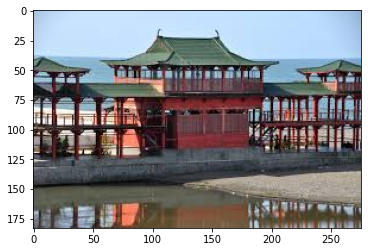

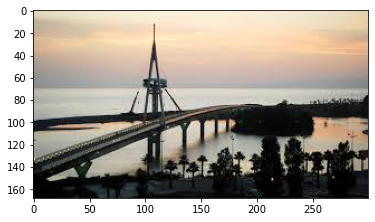

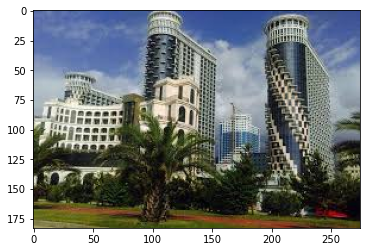

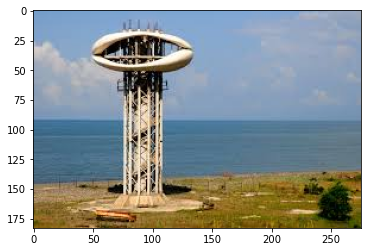

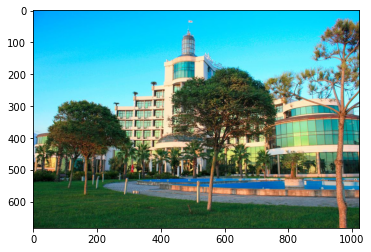

...

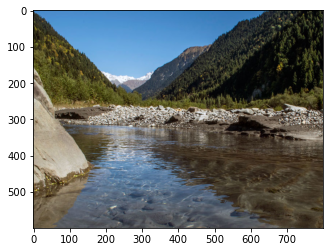

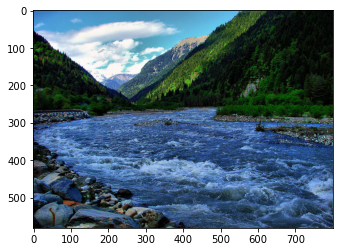

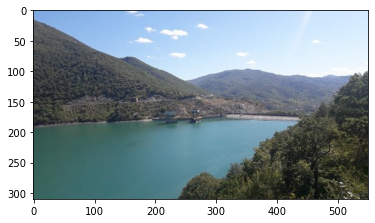

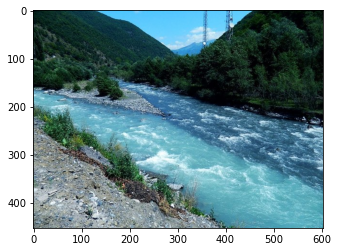

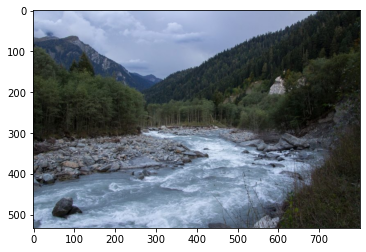

In [38]:
for im in imgs:
    plt.imshow(im)
    plt.show()
    plt.close()

#### Compare vectors

In [39]:
from scipy.spatial.distance import cosine

In [40]:
import matplotlib.pyplot as plt

In [41]:
def top_vecs(qi, top_k=5, model=img_vec, comp_vecs=img_vecs, normalize:bool=False):
    qv = model(qi)
    qv = qv / qv.norm(dim=-1, keepdim=True) if normalize else qv
    qv = qv[0]
    resul_pts = [(cosine(qv, vc), pt) for pt, vc in comp_vecs]
    resul_pts = sorted(resul_pts, key=lambda x: x[0], reverse=False)
    resul_pts = resul_pts[:top_k]
    
    return resul_pts

#### Query images

- ch_1.jpg
- ch_2.jpg
- ft_1.jpeg
- ft_2.jpg
- rv_1.jpeg
- rv_2.jpeg
- st_1.jpeg
- st_2.jpeg
- st_3.jpg
- ct_1.jpg
- ct_2.jpg

In [42]:
query_path = path / 'queries'
query_path.mkdir(exist_ok=True)

In [43]:
qim = read_img(query_path / 'st_2.jpeg')

In [44]:
res = top_vecs(qim)

In [45]:
#res

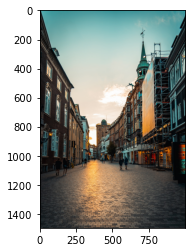

In [46]:
plt.imshow(qim)
plt.show()
plt.close()

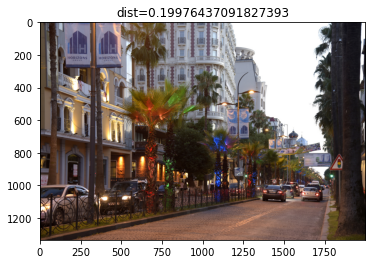

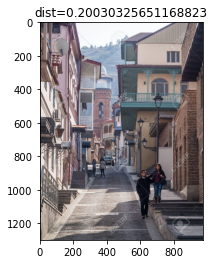

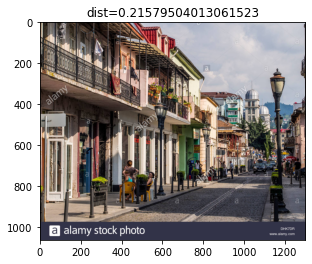

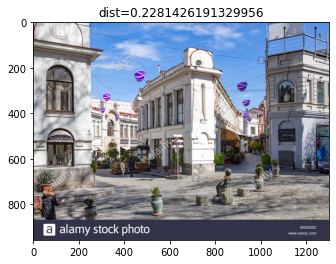

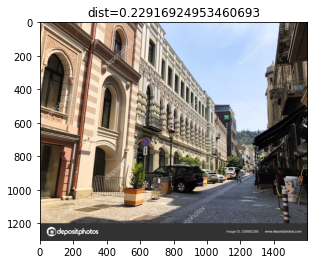

In [47]:
for dist, res_img in res:
    plt.title(f'dist={dist}')
    plt.imshow(res_img)
    plt.show()
    plt.close()

#### Go into the details

In [46]:
qim.shape

(177, 284, 3)

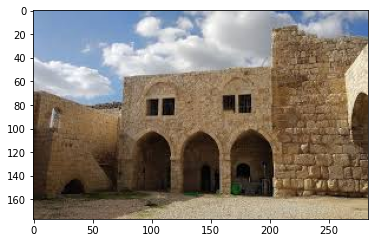

In [47]:
plt.imshow(qim)
plt.show()
plt.close()

In [48]:
qtens = img_vec.preprocess(qim)

In [49]:
backbone = img_vec.backbone
backbone

Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (0): Conv2d(6

In [50]:
conv_part = backbone[0][:-1]
pool_part = backbone[0][-1]
flat_part = backbone[-1]

In [51]:
conv_part

Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=F

In [78]:
pool_part

AdaptiveAvgPool2d(output_size=(1, 1))

In [81]:
flat_part

FlattenLayer()

In [ ]:
[111111]

In [ ]:
[img1, img2, img3, img4]
[img]

In [84]:
con_tens = conv_part(qtens)
con_tens[0].shape

torch.Size([2048, 7, 7])

In [85]:
pool_tens = pool_part(con_tens)
pool_tens[0].shape

torch.Size([2048, 1, 1])

In [86]:
lin_tens = flat_part(pool_tens)
lin_tens[0].shape

torch.Size([2048])

#### Search with CLIP model

``` pip install ftfy regex tqdm ```

``` pip install git+https://github.com/openai/CLIP.git ```

In [87]:
import clip

In [88]:
clip_net, clip_preprocess = clip.load('ViT-B/32', device=device, jit=False)

/Users/levan/anaconda3/envs/edu/lib/python3.9/site-packages/torchvision/transforms/transforms.py:257: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  warnings.warn(


In [89]:
img2clip = Img2Vec(clip_net, clip_preprocess, device=device, func=clip_net.encode_image, ptrf=lambda x: x / x.norm(dim=-1, keepdim=True))

In [90]:
plimgs = tqdm(pil_imgs, desc='Vectorizing images (PIL)', total=len(pil_imgs), position=0, leave=True)

Vectorizing images (PIL):   0%|          | 0/156 [00:00<?, ?it/s]

In [91]:
clip_vecs = [img2clip(im)[0] for im in plimgs]

Vectorizing images (PIL): 100%|██████████| 156/156 [00:40<00:00,  3.89it/s]


In [92]:
clip_vecs[0].shape, len(vecs)

((512,), 156)

- ch_1.jpg
- ch_2.jpg
- ft_1.jpeg
- ft_2.jpg
- rv_1.jpeg
- rv_2.jpeg
- st_1.jpeg
- st_2.jpeg
- st_3.jpg
- ct_1.jpg
- ct_2.jpg

In [93]:
pil_vecs = list(zip(imgs, clip_vecs))

In [68]:
clip_qim = read_pil_img(query_path / 'ft_1.jpeg')

In [69]:
clip_res = top_vecs(clip_qim, model=img2clip, comp_vecs=pil_vecs, normalize=False)

NameError: name 'img2clip' is not defined

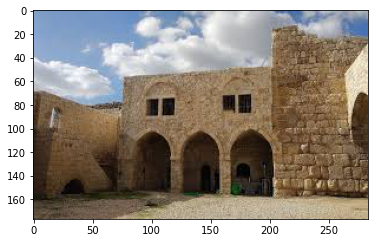

In [100]:
plt.imshow(clip_qim)
plt.show()
plt.close()

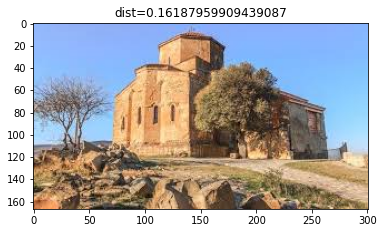

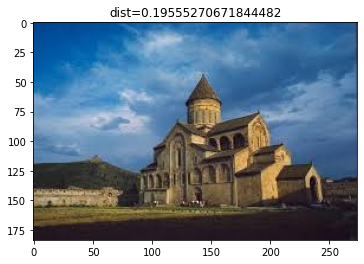

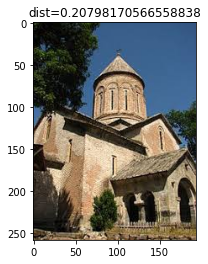

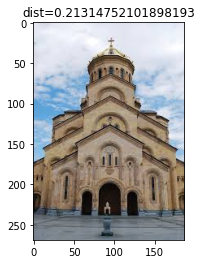

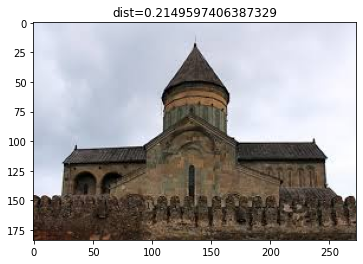

In [101]:
for dist, res_img in clip_res:
    plt.title(f'dist={dist}')
    plt.imshow(res_img)
    plt.show()
    plt.close()

## Text search

``` pip install -U sentence-transformers ```

In [108]:
from sentence_transformers import SentenceTransformer, util

In [109]:
model_dbr = SentenceTransformer('paraphrase-distilroberta-base-v1')

In [110]:
model_dbl = SentenceTransformer('stsb-bert-large')

In [ ]:
model_rbb = SentenceTransformer('stsb-roberta-base')

In [ ]:
model_rbl = SentenceTransformer('stsb-roberta-large')

In [112]:
#Our sentences we like to encode
sentences = ['This framework generates embeddings for each input sentence',
    'Sentences are passed as a list of string.',
    'The quick brown fox jumps over the lazy dog.']

#Sentences are encoded by calling model.encode()
embeddings = model_dbl.encode(sentences)

#Print the embeddings
for sentence, embedding in zip(sentences, embeddings):
    print("Sentence:", sentence)
    print("Embedding:", embedding)
    print(f'{embedding.shape=}')
    print("")

Sentence: This framework generates embeddings for each input sentence
Embedding: [-0.14775902 -1.0769002  -0.28034598 ... -0.48171046  0.14688689
 -0.07253686]
embedding.shape=(1024,)

Sentence: Sentences are passed as a list of string.
Embedding: [ 0.43923426 -0.6141906  -0.09331251 ... -0.20886284  0.26540694
  0.20385633]
embedding.shape=(1024,)

Sentence: The quick brown fox jumps over the lazy dog.
Embedding: [-0.1815027  -1.0670401  -0.1737926  ...  0.5633856  -0.84002495
 -0.49483562]
embedding.shape=(1024,)



## Semantic similarity

In [116]:
# Two lists of sentences
sentences1 = ['The cat sits outside',
             'A man is playing guitar',
             'The new movie is awesome']

sentences2 = ['The dog plays in the garden',
              'A woman watches TV',
              #'The new movie is so great',
              'The new movie is so horrable',
             ]

#Compute embedding for both lists
embeddings1 = model_dbl.encode(sentences1, convert_to_tensor=True)
embeddings2 = model_dbl.encode(sentences2, convert_to_tensor=True)

#Compute cosine-similarits
cosine_scores = util.pytorch_cos_sim(embeddings1, embeddings2)

#Output the pairs with their score
for i in range(len(sentences1)):
    print("{} \t\t {} \t\t Score: {:.4f}".format(sentences1[i], sentences2[i], cosine_scores[i][i]))

The cat sits outside 		 The dog plays in the garden 		 Score: 0.1092
A man is playing guitar 		 A woman watches TV 		 Score: -0.0546
The new movie is awesome 		 The new movie is so horrable 		 Score: 0.8448


## Search

In [117]:
embedder = SentenceTransformer('paraphrase-distilroberta-base-v1')

In [131]:
# Corpus with example sentences
corpus = ['A man is eating food.',
          'A man is eating a piece of bread.',
          'The girl is carrying a baby.',
          'A man is riding a horse.',
          'A woman is playing violin.',
          'Two men pushed carts through the woods.',
          'A man is riding a white horse on an enclosed ground.',
          'A monkey is playing drums.',
          'A cheetah is running behind its prey.',
          'A pasta is eating man .',
          'A pasta is eattyen by man .'
          ]
corpus_embeddings = embedder.encode(corpus, convert_to_tensor=True)

# Query sentences:
queries = ['A man is eating pasta.', 'Someone in a gorilla costume is playing a set of drums.', 'A cheetah chases prey on across a field.']


# Find the closest 5 sentences of the corpus for each query sentence based on cosine similarity
top_k = min(5, len(corpus))
for query in queries:
    query_embedding = embedder.encode(query, convert_to_tensor=True)

    # We use cosine-similarity and torch.topk to find the highest 5 scores
    cos_scores = util.pytorch_cos_sim(query_embedding, corpus_embeddings)[0]
    top_results = torch.topk(cos_scores, k=top_k)

    print("\n\n======================\n\n")
    print("Query:", query)
    print("\nTop 5 most similar sentences in corpus:")

    for score, idx in zip(top_results[0], top_results[1]):
        print(corpus[idx], "(Score: {:.4f})".format(score))

    """
    # Alternatively, we can also use util.semantic_search to perform cosine similarty + topk
    hits = util.semantic_search(query_embedding, corpus_embeddings, top_k=5)
    hits = hits[0]      #Get the hits for the first query
    for hit in hits:
        print(corpus[hit['corpus_id']], "(Score: {:.4f})".format(hit['score']))
    """





Query: A man is eating pasta.

Top 5 most similar sentences in corpus:
A pasta is eating man . (Score: 0.8338)
A man is eating food. (Score: 0.7096)
A pasta is eattyen by man . (Score: 0.6796)
A man is eating a piece of bread. (Score: 0.6074)
A man is riding a horse. (Score: 0.3360)




Query: Someone in a gorilla costume is playing a set of drums.

Top 5 most similar sentences in corpus:
A monkey is playing drums. (Score: 0.6842)
A woman is playing violin. (Score: 0.3762)
A man is riding a horse. (Score: 0.3079)
A cheetah is running behind its prey. (Score: 0.2760)
A man is eating a piece of bread. (Score: 0.2495)




Query: A cheetah chases prey on across a field.

Top 5 most similar sentences in corpus:
A cheetah is running behind its prey. (Score: 0.7814)
A monkey is playing drums. (Score: 0.2824)
A man is riding a white horse on an enclosed ground. (Score: 0.2208)
A man is riding a horse. (Score: 0.2017)
A man is eating food. (Score: 0.1886)


In [120]:
embedder

SentenceTransformer(
  (0): Transformer(
    (auto_model): RobertaModel(
      (embeddings): RobertaEmbeddings(
        (word_embeddings): Embedding(50265, 768, padding_idx=1)
        (position_embeddings): Embedding(514, 768, padding_idx=1)
        (token_type_embeddings): Embedding(1, 768)
        (LayerNorm): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
        (dropout): Dropout(p=0.1, inplace=False)
      )
      (encoder): RobertaEncoder(
        (layer): ModuleList(
          (0): RobertaLayer(
            (attention): RobertaAttention(
              (self): RobertaSelfAttention(
                (query): Linear(in_features=768, out_features=768, bias=True)
                (key): Linear(in_features=768, out_features=768, bias=True)
                (value): Linear(in_features=768, out_features=768, bias=True)
                (dropout): Dropout(p=0.1, inplace=False)
              )
              (output): RobertaSelfOutput(
                (dense): Linear(in_features=768, 

In [124]:
embedder_body = nn.Sequential(embedder)[-1]

In [129]:
embedder_body

SentenceTransformer(
  (0): Transformer(
    (auto_model): RobertaModel(
      (embeddings): RobertaEmbeddings(
        (word_embeddings): Embedding(50265, 768, padding_idx=1)
        (position_embeddings): Embedding(514, 768, padding_idx=1)
        (token_type_embeddings): Embedding(1, 768)
        (LayerNorm): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
        (dropout): Dropout(p=0.1, inplace=False)
      )
      (encoder): RobertaEncoder(
        (layer): ModuleList(
          (0): RobertaLayer(
            (attention): RobertaAttention(
              (self): RobertaSelfAttention(
                (query): Linear(in_features=768, out_features=768, bias=True)
                (key): Linear(in_features=768, out_features=768, bias=True)
                (value): Linear(in_features=768, out_features=768, bias=True)
                (dropout): Dropout(p=0.1, inplace=False)
              )
              (output): RobertaSelfOutput(
                (dense): Linear(in_features=768, 

In [127]:
sent_vec = embedder_body.encode('The test sentence')

In [128]:
sent_vec.shape

(768,)